# Regression @ Lat/Lon Level


In [1]:
import os
import sys

# hex2cec
sys.path.insert(0, "/Users/max/Development/green-last-mile/hex2vec")
from src.data.load_data import load_city_tag, load_filter
from src.data.make_dataset import h3_to_polygon


In [2]:
import numpy as np
import plotly.graph_objects as go
import pandas as pd
import geopandas as gpd
import h3


## Read in the DataFrame


In [3]:
# reading the hex2vec dataframe
tagged_df = pd.read_pickle(
    "/Users/max/Desktop/osmnx-cities/hexed-complete/Boston, MA/joined_routes_tags_30m.pkl"
)


In [4]:
tagged_df = tagged_df.loc[:, (tagged_df != 0).any(axis=0)]


In [5]:
tagged_df["planned_service_time_sum_log"] = np.log(tagged_df.planned_service_time_sum)


## Group the Data by Different H3 Levels


In [6]:
levels = [
    6,
    7,
    8,
    9,
    10,
    11,
]


In [7]:
for level in levels:
    tagged_df[f"h3_{level}"] = tagged_df[["lat", "lng"]].apply(
        lambda x: h3.geo_to_h3(*x, level), axis=1, raw=True
    )
    tagged_df[f"h3_{level}_mean"] = tagged_df.groupby(f"h3_{level}")[
        "planned_service_time_sum_log"
    ].transform("mean")
    tagged_df[f"h3_{level}_count"] = tagged_df.groupby(f"h3_{level}")[
        "planned_service_time_sum_log"
    ].transform("count")
    if level == 9:
        h3_9_gpd = tagged_df.groupby(f"h3_{level}")[["planned_service_time_sum"]].quantile(0.95)
        # rename the column
        h3_9_gpd = h3_9_gpd.rename(columns={"planned_service_time_sum": "planned_service_time_sum_95"})
        h3_9_gpd['planned_service_time_sum_5'] = tagged_df.groupby(f"h3_{level}")["planned_service_time_sum"].quantile(0.05)
        h3_9_gpd.reset_index(inplace=True, drop=False)
        h3_9_gpd = gpd.GeoDataFrame(
            h3_9_gpd[["h3_9", "planned_service_time_sum_95", "planned_service_time_sum_5"]],
            geometry=h3_9_gpd.apply(
                lambda x: h3_to_polygon(x[f"h3_{level}"]),
                axis=1,
            ),
        )
    tagged_df.drop(f"h3_{level}", axis=1, inplace=True)
    


### Create a GeoDataFrame from H9 hexagons


In [8]:
h3_9_gpd


,h3_9,planned_service_time_sum_95,planned_service_time_sum_5,geometry
0,892a302812bffff,54.90,29.70,"POLYGON ((-70.89818 42.30634, -70.90041 42.305..."
1,892a3028133ffff,293.92,58.20,"POLYGON ((-70.89149 42.30902, -70.89372 42.308..."
2,892a302813bffff,28.00,28.00,"POLYGON ((-70.89590 42.30903, -70.89813 42.308..."
3,892a3028163ffff,295.95,19.85,"POLYGON ((-70.90472 42.30903, -70.90695 42.308..."
4,892a3028167ffff,73.15,31.10,"POLYGON ((-70.90259 42.30634, -70.90482 42.305..."
...,...,...,...,...
21302,892a33daed7ffff,165.10,31.90,"POLYGON ((-71.71187 42.33905, -71.71408 42.338..."
21303,892a33db44fffff,75.00,75.00,"POLYGON ((-71.78865 42.40581, -71.79087 42.404..."
21304,892a33db69bffff,71.00,71.00,"POLYGON ((-71.79965 42.41381, -71.80187 42.412..."
21305,892a33db6b7ffff,57.00,57.00,"POLYGON ((-71.79089 42.40310, -71.79311 42.402..."


### Filter for only H3 with > X Data Points


In [9]:
tagged_df.shape, tagged_df.loc[tagged_df["h3_9_count"] >= 20].shape


((137667, 424), (35308, 424))

In [10]:
tagged_df = tagged_df.loc[tagged_df["h3_9_count"] > 20].copy().reset_index(drop=True)


In [11]:
for level in levels:
    tagged_df.drop([f"h3_{level}_count"], inplace=True, axis=1)

In [44]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=tagged_df["package_id_nunique"],
        y=tagged_df["planned_service_time_sum"],
        mode="markers",
    ),
)

In [45]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=tagged_df["package_id_nunique"],
        y=tagged_df["planned_service_time_mean"],
        mode="markers",
    ),
)

In [13]:
tagged_df['departure_datetime_mean'] = pd.to_datetime(tagged_df['departure_datetime_mean'])

In [33]:
tagged_df['departure_datetime_seconds'] = tagged_df['departure_datetime_mean'].dt.time.apply(lambda x: x.hour * 3600 + x.minute * 60 + x.second)
tagged_df['day_of_week'] = tagged_df['departure_datetime_mean'].dt.dayofweek

<AxesSubplot:>

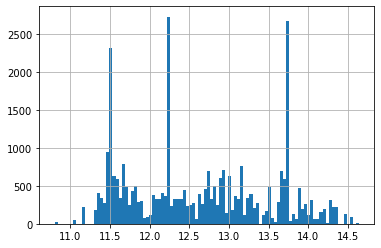

In [32]:
# TODO: add in the actual stop time 
(tagged_df['departure_datetime_seconds'] / 3600).hist(bins=100)

<AxesSubplot:>

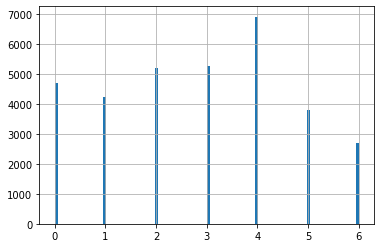

In [34]:
# TODO: add in the actual stop time 
tagged_df['day_of_week'].hist(bins=100)

## Plot the Lognormal Distribution of Service Times


In [15]:
# import plotly.figure_factory as ff

# ff.create_distplot(
#     [tagged_df.planned_service_time_sum, ],
#     ['data'],
#     show_rug=False
# )


In [16]:
# import numpy as np

# ff.create_distplot(
#     [np.log(tagged_df.planned_service_time_sum), ],
#     ['data'],
#     show_rug=False
# )


## Load the Filter and Create a List of Tag Columns


In [17]:
# find the tag columns. This is hacky.
from pathlib import Path

tag_filter = load_filter(
    Path("/Users/max/Development/green-last-mile/hex2vec/filters/from_wiki.json")
)
tag_columns = [
    f"{tag}_{sub}"
    for tag, subs in tag_filter.items()
    for sub in subs
    if f"{tag}_{sub}" in tagged_df.columns
]


### Convert the Tag Columns to Binary (if desired)


In [18]:
# tagged_df[tag_columns] = tagged_df[tag_columns].gt(0).astype(np.short)


## Downselect the Columns


In [19]:
keep_columns = tagged_df.columns.difference(
    [
        "lat",
        "lng",
        "route_id",
        "zone_id",
        "planned_service_time_mean",
        "planned_service_time_sum",
        "planned_service_time_min",
        "planned_service_time_max",
        "status",
        "departure_datetime_mean",
        "city",
        "city_zone",
        "h3",
    ]
)


In [20]:
h3_df = tagged_df[keep_columns].copy()


In [21]:
h3_df.reset_index(inplace=True, drop=True)


## Regression Model


In [22]:
from sklearn.model_selection import train_test_split

np.random.seed(0)

# getting rid of all the non-numeral data
df_train, df_test = train_test_split(
    h3_df.copy(), train_size=0.8, test_size=0.2, random_state=100
)


In [23]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler


scaler = MinMaxScaler()
scaler.fit(h3_df)

df_train = pd.DataFrame(
    scaler.transform(df_train), index=df_train.index, columns=df_train.columns
)
df_test = pd.DataFrame(
    scaler.transform(df_test), index=df_test.index, columns=df_test.columns
)


In [24]:
# Dividing data into X and y variables
y_train = df_train["planned_service_time_sum_log"]
X_train = df_train[df_train.columns.difference(["planned_service_time_sum_log"])]


In [25]:
# RFE
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor


In [26]:
from statsmodels.tools.tools import pinv_extended


def build_model(X, y):
    X = sm.add_constant(X)  # Adding the constant
    model = sm.OLS(y, X)
    lm = model.fit()
    # lm = model.fit_regularized(L1_wt=1)  # fitting the l1 model
    # pinv_wexog,_ = pinv_extended(model.wexog)
    # normalized_cov_params = np.dot(pinv_wexog, np.transpose(pinv_wexog))
    # summary = sm.regression.linear_model.OLSResults(model,lm.params,normalized_cov_params)
    # print(lm.summary())  # model summary
    print(lm.summary())
    return X, lm.pvalues


def checkVIF(X):
    vif = pd.DataFrame()
    vif["Features"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    vif["VIF"] = round(vif["VIF"], 2)
    vif = vif.sort_values(by="VIF", ascending=False)
    return vif


In [27]:
X_train_new, pvalues = build_model(X_train.astype("float"), y_train.astype("float"))
# insig_columns = [p.index for j, ind in enumerate(
#     pvalues) if pvalues[j] > 0.05]
insig_columns = pvalues.loc[pvalues > 0.05]


                                 OLS Regression Results                                 
Dep. Variable:     planned_service_time_sum_log   R-squared:                       0.702
Model:                                      OLS   Adj. R-squared:                  0.699
Method:                           Least Squares   F-statistic:                     250.8
Date:                          Wed, 07 Sep 2022   Prob (F-statistic):               0.00
Time:                                  10:23:47   Log-Likelihood:                 36836.
No. Observations:                         26230   AIC:                        -7.318e+04
Df Residuals:                             25985   BIC:                        -7.118e+04
Df Model:                                   244                                         
Covariance Type:                      nonrobust                                         
                                     coef    std err          t      P>|t|      [0.025      0.975]
-----------

In [28]:
X_train_new = X_train[
    X_train.columns.difference(
        [
            "h3_11_mean",
            "h3_10_mean",
            "h3_9_mean",
            "h3_8_mean",
            "h3_7_mean",
            "h3_6_mean",
            *tag_columns
        ]
    )
]


In [29]:
X_train_new, pvalues = build_model(X_train_new.astype("float"), y_train.astype("float"))
insig_columns = pvalues.loc[pvalues > 0.05]


                                 OLS Regression Results                                 
Dep. Variable:     planned_service_time_sum_log   R-squared:                       0.312
Model:                                      OLS   Adj. R-squared:                  0.312
Method:                           Least Squares   F-statistic:                     1486.
Date:                          Wed, 07 Sep 2022   Prob (F-statistic):               0.00
Time:                                  10:23:48   Log-Likelihood:                 25865.
No. Observations:                         26230   AIC:                        -5.171e+04
Df Residuals:                             26221   BIC:                        -5.164e+04
Df Model:                                     8                                         
Covariance Type:                      nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
---------------

In [30]:
imp_pvalues = pvalues[pvalues.argsort()][:16]
imp_features = pvalues.index[pvalues.argsort()][:16]

fig = go.Figure(data=[go.Bar(y=imp_features, x=imp_pvalues, orientation="h")])
fig.update_layout(
    xaxis_title="p-values",
    yaxis_title="Features",
    title="Most Significant features for OLS Model",
)

fig.show()
# fig.update_layout(barmode='horizontal')


In [27]:
X_train_new = X_train.drop(X_train.columns.intersection(insig_columns.index), axis=1)


In [28]:
X_train_new, pvalues = build_model(X_train_new, y_train)
insig_columns = pvalues.loc[pvalues > 0.05]


                                 OLS Regression Results                                 
Dep. Variable:     planned_service_time_sum_log   R-squared:                       0.700
Model:                                      OLS   Adj. R-squared:                  0.700
Method:                           Least Squares   F-statistic:                     1359.
Date:                          Wed, 07 Sep 2022   Prob (F-statistic):               0.00
Time:                                  09:58:13   Log-Likelihood:                 36763.
No. Observations:                         26230   AIC:                        -7.343e+04
Df Residuals:                             26184   BIC:                        -7.306e+04
Df Model:                                    45                                         
Covariance Type:                      nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
-----------------

In [29]:
# Calculating the Variance Inflation Factor
# checkVIF(X_train_new)


In [30]:
imp_pvalues = pvalues[pvalues.argsort()][:16]
imp_features = pvalues.index[pvalues.argsort()][:16]

fig = go.Figure(data=[go.Bar(y=imp_features, x=imp_pvalues, orientation="h")])
fig.update_layout(
    xaxis_title="p-values",
    yaxis_title="Features",
    title="Most Significant features for OLS Model",
)

fig.show()
# fig.update_layout(barmode='horizontal')


In [31]:
len(X_train_new.columns)


104

In [29]:
# X_train_new = X_train[X_train.columns.difference(['h3_11_mean', 'h3_10_mean', 'h3_10_mean', 'h3_8_mean', 'h3_7_mean', 'h3_6_mean', *tag_columns])]
X_train_new = X_train[
    X_train.columns.difference(
        [
            "h3_11_mean",
            "h3_10_mean",
            "h3_9_mean",
            "h3_8_mean",
            "h3_7_mean",
            "h3_6_mean",
            *tag_columns
        ]
    )
]


In [30]:
lm = sm.OLS(y_train, X_train_new).fit()
y_train_price = lm.predict(X_train_new)


In [31]:
# Plot the histogram of the error terms
fig = go.Figure()

fig.add_trace(
    go.Histogram(
        x=(y_train - y_train_price), name="Error Terms", marker_color="indianred"
    )
)


In [40]:
# Dividing into X and y
y_test = df_test["planned_service_time_sum_log"].astype("float")
X_test = df_test[df_test.columns.difference(["planned_service_time_sum_log"])].astype(
    "float"
)


In [33]:
def get_sigf_cols_df(df):
    # Creating X_test_new dataframe by dropping variables from X_test
    # df = sm.add_constant(df)
    df["const"] = 1
    df = df[X_train_new.columns]
    return df


# Adding a constant variable
X_test_new = get_sigf_cols_df(X_test)
# Full_data_h3 = get_sigf_cols_df(Full_data_h3)


In [34]:
# Making predictions
y_pred = lm.predict(X_test_new)


In [35]:
from sklearn.metrics import r2_score

r2_score(y_test, y_pred)


0.08578938563831984

In [36]:
# EVALUATION OF THE MODEL
# plot y_test vs. y_pred
fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=y_test,
        y=y_pred,
        mode="markers",
        marker=dict(
            color="rgba(152, 0, 0, .8)",
        ),
    )
)

fig.update_layout(
    title="OLS",
    xaxis_title="y_test",
    yaxis_title="y_pred",
    # yaxis_range=[0, 10],
)


### Evaluating the OLS Error


In [40]:
df_test_w_pred = df_test.copy()
tagged_df_test = tagged_df.loc[df_test.index].copy(deep=True)


#### Creating Q5-Q95 windows


In [41]:
for level in levels:
    tagged_df_test[f"h3_{level}"] = tagged_df_test[["lat", "lng"]].apply(
        lambda x: h3.geo_to_h3(*x, level), axis=1, raw=True
    )
    grouper = tagged_df_test.groupby(f"h3_{level}")["planned_service_time_sum_log"]
    tagged_df_test[f"h3_{level}_count"] = grouper.transform("count")
    tagged_df_test[f"h3_{level}_95_diff"] = grouper.transform(
        lambda df: np.exp(df.quantile(0.95)) - np.exp(df.quantile(0.5))
    )
    tagged_df_test[f"h3_{level}_5_diff"] = grouper.transform(
        lambda df: np.exp(df.quantile(0.5)) - np.exp(df.quantile(0.05))
    )
    # tagged_df[f"h3_{level}_std"] = grouper.transform("std")
    # tagged_df[f"h3_{level}_std"].fillna(0, inplace=True)
    # tagged_df_test.drop(f"h3_{level}", axis=1, inplace=True)


#### Selecting Location where Prediction is outside 5% and 95% quantile


In [42]:
df_test_w_pred["planned_service_time_sum_log"] = y_pred
df_test_w_pred = pd.DataFrame(
    scaler.inverse_transform(df_test_w_pred),
    index=df_test_w_pred.index,
    columns=df_test_w_pred.columns,
)
df_test_transformed = pd.DataFrame(
    scaler.inverse_transform(df_test.copy()),
    index=df_test.index,
    columns=df_test.columns,
)
tagged_df_test["predicted_planned_service_time_sum_log"] = df_test_w_pred[
    "planned_service_time_sum_log"
]


#### Reverse the Log Transformation


In [43]:
tagged_df_test[
    ["planned_service_time_sum", "predicted_planned_service_time_sum",]
] = tagged_df_test[
    ["planned_service_time_sum_log", "predicted_planned_service_time_sum_log",]
].apply(
    lambda x: np.exp(x)
)


In [44]:
error_loc = tagged_df_test.loc[
    (tagged_df_test["h3_9_count"] > 10)
    & (
        (
            (
                tagged_df_test["predicted_planned_service_time_sum"]
                - tagged_df_test["planned_service_time_sum"]
            )
            > tagged_df_test["h3_9_95_diff"]
        )
        | (
            (
                tagged_df_test["planned_service_time_sum"]
                - tagged_df_test["predicted_planned_service_time_sum"]
            )
            > tagged_df_test["h3_9_5_diff"]
        )
    )
].copy()

error_loc['error'] = (error_loc['planned_service_time_sum'] - error_loc['predicted_planned_service_time_sum']).abs()

error_loc.head()


,lat,lng,route_id,package_id_nunique,volume_mean,volume_sum,width_mean,height_mean,planned_service_time_mean,planned_service_time_sum,...,h3_9_5_diff,h3_10,h3_10_95_diff,h3_10_5_diff,h3_11,h3_11_95_diff,h3_11_5_diff,predicted_planned_service_time_sum_log,predicted_planned_service_time_sum,error
19838,42.334865,-71.051729,RouteID_a5579eb3-6584-4a92-97e1-a6909d39f560,3,3397.924333,10193.773,18.70,5.433333,59.3,177.9,...,82.806205,8a2a3066c497fff,46.267499,50.276046,8b2a3066c496fff,0.000000,0.000000,4.486701,88.827892,89.072108
7936,42.262747,-70.989076,RouteID_912afd28-8e06-4075-b656-6b7a95cced93,2,3596.930000,7193.860,23.35,7.150000,34.5,69.0,...,9.209645,8a2a3029b2cffff,25.971823,10.608604,8b2a3029b2c9fff,0.000000,0.000000,3.930343,50.924448,18.075552
3271,42.156720,-71.530656,RouteID_7a33cce4-a66f-472f-ae30-e0506ce6dd87,1,5741.924000,5741.924,17.80,12.700000,142.0,142.0,...,65.205042,8a2a33d5ab4ffff,74.596835,105.904392,8b2a33d5ab49fff,42.199119,34.168153,3.830925,46.105153,95.894847
18870,42.330888,-71.056982,RouteID_b5dc1f6f-3c9b-4be7-9291-f079549caf48,4,10322.141250,41288.565,20.25,11.825000,161.5,646.0,...,125.959862,8a2a3066eb9ffff,129.873940,111.096624,8b2a3066eb9dfff,0.000000,0.000000,5.429295,227.988467,418.011533
2951,42.140788,-71.526748,RouteID_315651ac-bc80-4c50-99ac-25349bf3c5f9,2,5053.591000,10107.182,29.60,4.050000,69.0,138.0,...,36.925649,8a2a33d5b14ffff,50.080941,39.851415,8b2a33d5b14bfff,43.341428,29.113962,4.284837,72.590689,65.409311


In [45]:
import plotly.express as px


In [46]:
from geojson import Feature, FeatureCollection


def hexagons_dataframe_to_geojson(
    df_hex, hex_id_field, geometry_field, value_field, file_output=None
):
    list_features = []

    for i, row in df_hex.iterrows():
        feature = Feature(
            geometry=row[geometry_field],
            id=row[hex_id_field],
            properties={"value": row[value_field]},
        )
        list_features.append(feature)

    return FeatureCollection(list_features)


In [47]:
hex_geo_json = hexagons_dataframe_to_geojson(
    h3_9_gpd,
    "h3_9",
    "geometry",
    "h3_9",
)


In [49]:
# h3_9_gpd["planned_service_time_sum"] = h3_9_gpd["planned_service_time_sum_log"].apply(
#     lambda x: np.exp(x)
# )

# filter for only the hexagons that have a value
h3_9_gpd = h3_9_gpd.loc[h3_9_gpd["h3_9"].isin(error_loc["h3_9"].unique())]


In [51]:
import dotenv
dotenv.load_dotenv()


fig = px.choropleth_mapbox(
    h3_9_gpd,
    geojson=hex_geo_json,
    locations="h3_9",
    # color="blue",
    # color_continuous_scale=px.colors.sequential.Plasma,
    # range_color=(0, 1),
    # mapbox_style="carto-positron",
    # zoom=11,
    center={"lat": error_loc.lat.mean(), "lon": error_loc.lng.mean()},
    opacity=0.4,
    labels={"planned_service_time_sum"},
)

fig.add_trace(
    go.Scattermapbox(
        lat=h3_9_gpd.geometry.centroid.y,
        lon=h3_9_gpd.geometry.centroid.x,
        text=h3_9_gpd[["planned_service_time_sum_5", "planned_service_time_sum_95"]].apply(lambda x: f"[{x[0]:.2f}, {x[1]:.2f}]", axis=1),
        textfont={"color":"white","size":20, "family":"Courier New"},
        mode="text",
        # name="Bergeron"
    )
)

fig.add_trace(
    px.scatter_mapbox(
        error_loc,
        lat="lat",
        lon="lng",
        color="error",
        size="error",
        color_continuous_scale=px.colors.sequential.Greens_r,
        size_max=50,
        zoom=10,
        hover_data=["planned_service_time_sum", "predicted_planned_service_time_sum", ],
        # mapbox_style="open-street-map",
    ).data[0]
)

fig.update_mapboxes(
    go.layout.Mapbox(
        accesstoken=os.environ.get("MAPBOX_KEY"),
        style="mapbox://styles/max-schrader/cl6lhvrfw001516pkh3s6iv7l",
        bearing=0,
        zoom=10,
    )
)

fig.show()


- Creating the entire dataset for prediction:


In [57]:
# np.random.seed(0)

# # getting rid of all the non-numeral data
# tagged_df_test = tagged_df.drop(['lat', 'lng', 'route_id','has_window_max', 'city','city_zone', 'zone_id', 'status', 'departure_datetime_mean',
#                                 'h3', 'planned_service_time_min', 'planned_service_time_max', 'planned_service_time_mean','planned_service_time_sum',
#                                 'planned_service_time_sum_grp_avg', 'planned_service_time_sum_grp_sum','hex_predicted_service_time_sum',
#                                  'discrepency_sum','hex_predicted_service_time_avg','discrepency_avg', 'h3_predicted_service_time_avg', 'h3_predicted_service_time_sum'], axis=1)
# tagged_df_test = pd.DataFrame(
#     scaler.fit_transform(tagged_df_test), index=tagged_df_test.index, columns=tagged_df_test.columns)


# # Now let's use our model to make predictions.
# for_col_df = X_train_new.drop('const', axis=1)
# # Creating X_test_new dataframe by dropping variables from X_test
# tagged_X_test_new = tagged_df_test[for_col_df.columns]

# # Adding a constant variable
# tagged_X_test_new = sm.add_constant(tagged_X_test_new)


# # Making predictions
# tagged_df_hex_sum['h3_predicted_service_time_' + f'{type}'] = lm.predict(Full_data_h3)
# tagged_df['hex_predicted_service_time_'+ f'{type}'] = lm.predict(tagged_X_test_new)

# # Calculating Discrepancies
# tagged_df['discrepency_'+ f'{type}'] = tagged_df['planned_service_time_sum'] - tagged_df['hex_predicted_service_time_'+ f'{type}']

# # For hexagonal level prediction by just using hexagonal fetaures which are summed and averaged
# tagged_df = tagged_df.join(tagged_df_hex_sum.set_index('h3')['h3_predicted_service_time_' + f'{type}'], on='h3')

# # save this dataframe
# pd.to_pickle(tagged_df, '/gcsmount-notebook/navish/dataframes/hexagonal_regression_pred_df.pkl')


In [ ]:
# def scatter(x,y, fig):
#     plt.subplot(5,2,fig)
#     plt.scatter(tagged_df[x], tagged_df[y])
#     # plt.suptitle('OLS')
#     plt.xlabel(x)
#     plt.ylabel(y)

# plt.figure(figsize=(10,20))

# scatter('h3_predicted_service_time_'+ f'{type}', 'planned_service_time_sum', 1)
# scatter('h3_predicted_service_time_'+ f'{type}', 'planned_service_time_sum_grp_'+ f'{type}', 2)
# scatter('hex_predicted_service_time_'+ f'{type}', 'planned_service_time_sum', 3)
# scatter('hex_predicted_service_time_'+ f'{type}', 'planned_service_time_sum_grp_'+ f'{type}', 4)


# plt.tight_layout()


In [58]:
# print(lm.summary())


## Regression using other algorithms


In [44]:
np.random.seed(0)

# getting rid of all the non-numeral data
df_train, df_test = train_test_split(
    h3_df
    # tagged_df_hex.drop(
    #     [
    #         "lat",
    #         "lng",
    #         "has_window_max",
    #         "h3",
    #         "planned_service_time_min",
    #         "planned_service_time_max",
    #         "planned_service_time_mean",
    #     ],
    #     axis=1,
    # ),
    # train_size=0.8,
    # test_size=0.2,
    # random_state=100,
)

scaler = StandardScaler()
scaler.fit(df_train)

# num_vars = ['height', 'width', 'volume', 'intraday_sec', 'planned_service_time']
# df_train[num_vars] = scaler.fit_transform(df_train[num_vars])

df_train = pd.DataFrame(
    scaler.fit_transform(df_train), index=df_train.index, columns=df_train.columns
)

# Dividing data into X and y variables
y_train = df_train.pop("planned_service_time_sum_log")
X_train = df_train.reset_index(drop=True)


In [46]:
# Scaling the test set

# If we want to only scale certain features
# num_vars = ['height','width', 'city_zone_2_num', 'month']
# df_test[num_vars] = scaler.fit_transform(df_test[num_vars])

df_test = pd.DataFrame(
    scaler.fit_transform(df_test), index=df_test.index, columns=df_test.columns
)

# Dividing data into X and y variables
y_test = df_test.pop("planned_service_time_sum_log")
X_test = df_test.reset_index(drop=True)


1. AdaBoost


In [47]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor

AdaBoost = AdaBoostRegressor(
    random_state=0,
    base_estimator=DecisionTreeRegressor(max_depth=3),
    loss="linear",
    n_estimators=2000,
)
AdaBoost.fit(X_train, y_train)


AdaBoostRegressor(base_estimator=DecisionTreeRegressor(max_depth=3),
                  n_estimators=2000, random_state=0)

In [48]:
AdaBoost.score(X_train, y_train)


0.7306151722942142

In [49]:
AdaBoost.score(X_test, y_test)


0.7291997777568715

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=y_test,
        y=y_pred,
        mode="markers",
        marker=dict(
            color="rgba(152, 0, 0, .8)",
        ),
    )
)

fig.update_layout(
    title="AdaBoost",
    xaxis_title="y_test",
    yaxis_title="y_pred",
    # yaxis_range=[0, 10],
)


3. ExtraTrees


In [46]:
from sklearn.ensemble import ExtraTreesRegressor

ET = ExtraTreesRegressor(random_state=0, n_estimators=2000, n_jobs=-1)
ET.fit(X_train, y_train)


ExtraTreesRegressor(n_estimators=2000, n_jobs=-1, random_state=0)

In [47]:
ET.score(X_train, y_train)


0.9999614637011535

In [48]:
ET.score(X_test, y_test)


0.6634550786491029

In [54]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(
        x=y_test,
        y=y_pred,
        mode="markers",
        marker=dict(
            color="rgba(152, 0, 0, .8)",
        ),
    )
)

fig.update_layout(
    title="ET",
    xaxis_title="y_test",
    yaxis_title="y_pred",
    # yaxis_range=[0, 10],
)


4. GradientBoost


In [55]:
from sklearn.ensemble import GradientBoostingRegressor

GB = GradientBoostingRegressor(
    random_state=0, learning_rate=0.1, loss="huber", n_estimators=20
)
GB.fit(X_train, y_train)


GradientBoostingRegressor(loss='huber', n_estimators=20, random_state=0)

In [56]:
GB.score(X_train, y_train)


0.7530308331252273

In [57]:
GB.score(X_test, y_test)


0.7510858875687685

5. RandomForest


In [38]:
from sklearn.ensemble import RandomForestRegressor

RF = RandomForestRegressor(random_state=0, n_estimators=2000, n_jobs=-1)
RF.fit(X_train, y_train)


RandomForestRegressor(n_estimators=2000, n_jobs=-1, random_state=0)

In [39]:
RF.score(X_train, y_train)


0.9553517688354737

In [42]:
RF.score(X_test, y_test)


0.6870432697388266

### Seeing the Feature Importance


In [63]:
# !pip install shap


In [64]:
import shap


In [65]:
def plot_importance(name, regr):
    sorted_idx = regr.feature_importances_.argsort()
    plt.barh(
        X_train.columns[sorted_idx[-25:]], regr.feature_importances_[sorted_idx[-25:]]
    )
    plt.xlabel(f"{name} Feature Importance")


In [ ]:
from sklearn.inspection import permutation_importance


def perm_importance(name, regr):
    perm_importance = permutation_importance(regr, X_test, y_test)
    sorted_idx = perm_importance.importances_mean.argsort()
    plt.barh(
        X_train.columns[sorted_idx[-20:]],
        perm_importance.importances_mean[sorted_idx[-20:]],
    )
    plt.xlabel(f"{name} Permutation Importance")


#### Visualisation using SHAP


In [73]:
def shap_plots(name, regr, plot_type="dot"):

    explainer = shap.TreeExplainer(regr, check_additivity=False)
    shap_values = explainer.shap_values(X_test)

    # Feature value ('dot') or just feature importance ('bar)
    shap.summary_plot(shap_values[:20], X_test, plot_type)


#### Let's compare now!


1. AdaBoost


In [74]:
shap_plots("AdaBoost", AdaBoost)


InvalidModelError: Model type not yet supported by TreeExplainer: <class 'sklearn.ensemble._weight_boosting.AdaBoostRegressor'>

In [ ]:
# perm_importance('AdaBoost', AdaBoost)


In [ ]:
# shap_plots('AdaBoost', AdaBoost, 'dot')


2. ExtraTrees


In [ ]:
plot_importance("ET", ET)


In [75]:
shap_plots("ET", ET, "dot")


3. GradientBoost


In [ ]:
plot_importance("GB", GB)


In [ ]:
shap_plots("GB", GB, "dot")


4. RandomForest


In [ ]:
plot_importance("RF", RF)


In [ ]:
# shap_plots('RF', RF, 'dot')


##### Plotting the within zone discrepencies on Test Data


In [ ]:
df_test.head()
